# Using the RCW module

The RCW module of pySCATMECH implements the `SCATMECH::RCW_Model` class, which is a rigorous coupled wave (RCW) solver for one-dimensionally periodic gratings. This notebook will demonstrate a number of its features.

First, we import the module. Since we are also using `numpy` and `matplotlib`, we will import those, too.

In [1]:
import matplotlib.pyplot as plt
import numpy as np
from pySCATMECH.rcw import *

## Single line grating

We will start our demonstration with a single line grating.  We can create a `RCW_Model` with parameters:

In [2]:
gratingParameters = {
    None : 'Single_Line_Grating', # The Grating model can be assigned with the `None` key
    'period' : 0.2,               # The period  
    'medium_i' : 1,               # The incident medium0
    'medium_t' : 'silicon',       # The transmitting (substrate) material
    'material' : 'silicon',       # The grating material
    'space' : 1,                  # The space material
    'height' : 0.2,               # The height
    'topwidth' : 0.1,             # Top width
    'bottomwidth' : 0.15,         # Bottom width
    'offset' : 0,                 # Offset of top, relative to bottom
    'nlevels' : 10}               # Number of layers in the staircase approximation

rcwParameters = {
    'order' : 25,                 # number of Floquet orders considered
    'type' : 0,                   # 0 indicates reflection
    'lambda' : 0.532,             # wavelength
    'thetai' : 70,                # incident angle in degrees 
    'rotation' : 0,               # rotation angle in degrees
    'grating' : gratingParameters
    }

model = RCW_Model(rcwParameters)

print(model)

{None : 'RCW_Model',
'order' : '25',
'type' : '0',
'lambda' : '0.532',
'thetai' : '70',
'rotation' : '0',
'grating' : {None : 'Single_Line_Grating',
              'period' : '0.2',
              'medium_i' : '(1,0)',
              'medium_t' : 'silicon',
              'material' : 'silicon',
              'space' : '(1,0)',
              'height' : '0.2',
              'topwidth' : '0.1',
              'bottomwidth' : '0.15',
              'offset' : '0',
              'nlevels' : '10'}}


Let's show the NCS parameters for the 0th order diffraction (specular) as a function of wavelength:

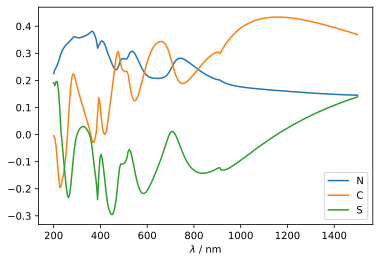

In [3]:
# 250 wavelengths from 0.2 to 1.5...
wavelengths = np.linspace(0.2, 1.5, 250)

def rcw(wavelength):
    rcwParameters['lambda'] = wavelength
    model.setParameters(rcwParameters)
    return model.DiffractionEfficiency(0)

muellerMatrices = [rcw(wavelength) for wavelength in wavelengths]
N = [m[0,1] for m in muellerMatrices]
C = [m[2,2] for m in muellerMatrices]
S = [m[2,3] for m in muellerMatrices]

plt.plot(wavelengths*1000, N, label="N")
plt.plot(wavelengths*1000, C, label="C")
plt.plot(wavelengths*1000, S, label="S")
plt.xlabel('$\lambda$ / nm')
plt.legend()
plt.show()

Let's do the same thing, but rotate the sample 45 degrees. The Mueller matrices are no longer block diagonal.

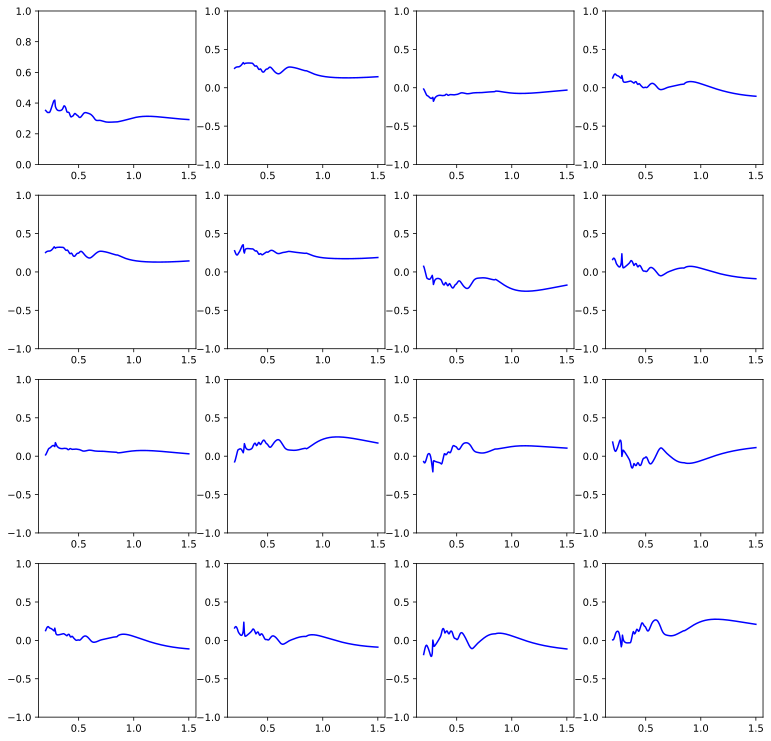

In [4]:
wavelengths = np.linspace(0.2, 1.5, 250)

rcwParameters['rotation'] = 45
model.setParameters(rcwParameters)

def rcw(wavelength):
    rcwParameters['lambda'] = wavelength
    model.setParameters(rcwParameters)
    return model.DiffractionEfficiency(0)

muellerMatrices = [rcw(wavelength) for wavelength in wavelengths]

plt.figure(figsize = [13,13])
for element in range(16):
    plt.subplot(4,4,element+1)
    if element==0:
        plt.ylim(0,1)
    else:
        plt.ylim(-1,1)
    plt.plot(wavelengths,[m[element//4,element%4] for m in muellerMatrices],'b-')

plt.show()

What does this grating look like?

In [5]:
def showGrating(model,x,z):
    xx, zz = np.meshgrid(x, z, sparse=True)

    def eps(x,z):
        return model.getEpsilon(x,z).real

    epsilon = np.array([[eps(x0,z0) for x0 in x] for z0 in z])

    fig = plt.figure(figsize=(6,5))
    ax = fig.add_subplot(111)
    h = ax.contourf(x,z,epsilon,256,cmap="brg")
    plt.colorbar(h,ax=ax)

    plt.show()
    
showGrating(model,np.linspace(-0.2, 0.2, 200),np.linspace(-0.3,.1,200))

One can view the diffraction pattern:

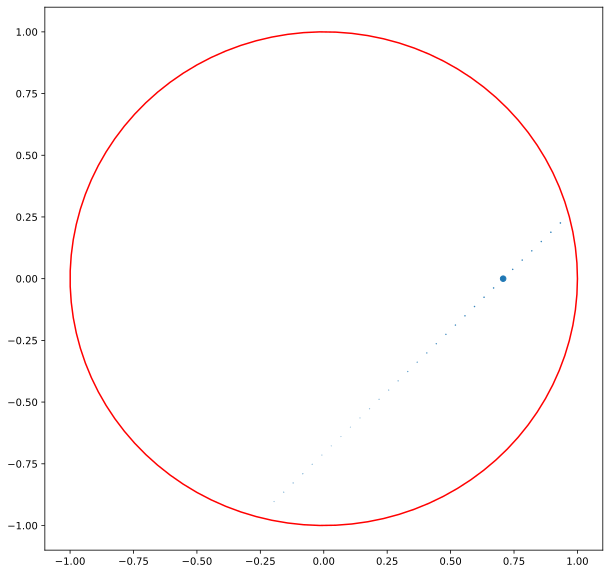

In [6]:
gratingParameters = {
    None : 'Single_Line_Grating',
    'period' : 10,
    'medium_i' : 1,
    'medium_t' : 'silicon',  
    'material' : 'silicon',
    'space' : 1,
    'height' : '0.5',
    'topwidth' : '0.4',
    'bottomwidth' : '0.15',
    'offset' : '0',
    'nlevels' : '10'}

rcwParameters = {
    None : 'RCW_Model',
    'order' : '25',
    'type' : '0',
    'lambda' : '0.532',
    'thetai' : 45,
    'rotation' : 45,
    'grating' : gratingParameters
    }

model.setParameters(rcwParameters)

def plotDiffractionPattern(model):
    order = int(model.getParameter("order"))
    x, y, I = [], [], []
    for i in range(-order,order):
        direction = model.Direction(i)
        if direction[2] != 0 :
            x.append(direction[0])
            y.append(direction[1])
            I.append(model.DiffractionEfficiency(i)[0,0])
       
    thetas = np.linspace(0, 2*pi, 100)
    circlex = np.cos(thetas)
    circley = np.sin(thetas)
    
    plt.figure(figsize = (10,10))
    ax = plt.subplot(111)
    ax.scatter(x, y, s=np.array(I)*100) 
    ax.plot(circlex, circley, c = 'r')
    plt.show()

plotDiffractionPattern(model)

## Blazed reflection grating

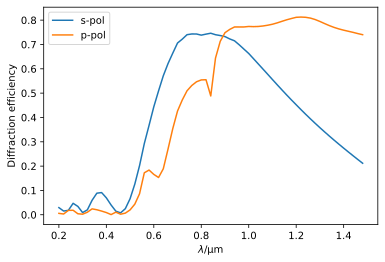

In [7]:
# Set the lines per millimeter:
lpm = 600
# Set the nominal wavelength in µm:
blazeLambda = 1.00

##########################
period = 1000/lpm
sinBlaze = blazeLambda/2/period
height = period*sinBlaze
##########################

# Description of the grating...
gratingParameters = {None: 'Triangular_Grating', 
                     'period': 1000/lpm, 
                     'medium_i': 1, 
                     'medium_t': 'aluminum', 
                     'material': 'aluminum',
                     'amplitude' : height,
                     'aspect' : 1,
                     'nlevels' : 20}

# The RCW parameters
rcwParameters = {
    None : 'RCW_Model',
    'order' : 25,
    'type' : 0,
    'lambda' : 0.500,
    'thetai' : 0,
    'rotation' : 0,
    'grating' : gratingParameters
    }
model = RCW_Model(rcwParameters)

def efficiency(wavelength):
    """Set the wavelength and calculate the efficiency"""
    thetai=math.asin(wavelength/2/period)
    model.setParameters(wavelength=wavelength,thetai=thetai)
    return model.DiffractionEfficiency(1)

wavelengths = np.arange(0.2, 1.5, 0.02)

eff = [efficiency(L) for L in wavelengths]
effs = [Sensitivity('u') @ e @ Polarization('s') for e in eff]
effp = [Sensitivity('u') @ e @ Polarization('p') for e in eff]

plt.figure()
plt.plot(wavelengths, effs, label = "s-pol")
plt.plot(wavelengths, effp, label = "p-pol")
plt.xlabel("$\lambda$/µm")
plt.ylabel("Diffraction efficiency")
plt.legend()
plt.show()

showGrating(model,np.linspace(-6, 6, 200),np.linspace(-6,6,200))

## Sinusoidal transmission grating 

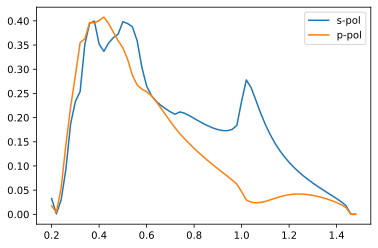

In [8]:
# Set the lines per millimeter:
lpm = 1000
# Sinusoid amplitude:
amplitude = .5
# Incident angle:
thetai = 45*deg


period = 1000/lpm
from pySCATMECH.fresnel import OpticalFunction

FusedSilica = OpticalFunction(lambda L: 1.4580 + 0.00354/L**2, np.arange(0.2,1.5,0.05))

# Description of the grating...
gratingParameters = {None: 'Sinusoidal_Relief_Grating', 
                     'period': period, 
                     'medium_i': 1, 
                     'medium_t': FusedSilica, 
                     'material': FusedSilica,
                     'amplitude' : amplitude,
                     'base' : 0,
                     'option' : 0,
                     'nlevels' : 20}

# The RCW parameters
rcwParameters = {
    None : 'RCW_Model',
    'order' : 10,
    'type' : 1,
    'lambda' : 0.500,
    'thetai' : 0,
    'rotation' : 0,
    'grating' : gratingParameters
    }
model = RCW_Model(rcwParameters)

def efficiency(wavelength):
    """Set the wavelength and calculate the efficiency"""
    rcwParameters['lambda'] = wavelength
    model.setParameters(rcwParameters)
    return model.DiffractionEfficiency(1)

wavelengths = np.arange(0.2, 1.5, 0.02)

eff = [efficiency(L) for L in wavelengths]

effs = [Sensitivity('u') @ e @ Polarization('s') for e in eff]
effp = [Sensitivity('u') @ e @ Polarization('p') for e in eff]

plt.figure()
plt.plot(wavelengths, effs, label = "s-pol")
plt.plot(wavelengths, effp, label = "p-pol")
plt.legend()
plt.show()

showGrating(model,np.linspace(-6, 6, 200),np.linspace(-6,6,200))